In [1]:
#basic import 
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings('ignore')
sns.set_style('dark')
import torch
import torch.nn as nn
import torch.nn.functional as F
device = torch.device("mps")

In [2]:
train_df = pd.read_csv('/Users/aadityajoshi/Downloads/archive-17/train.csv',index_col=0)
test_df = pd.read_csv('/Users/aadityajoshi/Downloads/archive-17/test.csv',index_col=0)

In [3]:
train_df.head()

,id,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,...,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes,satisfaction
0,70172,Male,Loyal Customer,13,Personal Travel,Eco Plus,460,3,4,3,...,5,4,3,4,4,5,5,25,18.0,neutral or dissatisfied
1,5047,Male,disloyal Customer,25,Business travel,Business,235,3,2,3,...,1,1,5,3,1,4,1,1,6.0,neutral or dissatisfied
2,110028,Female,Loyal Customer,26,Business travel,Business,1142,2,2,2,...,5,4,3,4,4,4,5,0,0.0,satisfied
3,24026,Female,Loyal Customer,25,Business travel,Business,562,2,5,5,...,2,2,5,3,1,4,2,11,9.0,neutral or dissatisfied
4,119299,Male,Loyal Customer,61,Business travel,Business,214,3,3,3,...,3,3,4,4,3,3,3,0,0.0,satisfied


In [4]:
test_df.head()

,id,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,...,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes,satisfaction
0,19556,Female,Loyal Customer,52,Business travel,Eco,160,5,4,3,...,5,5,5,5,2,5,5,50,44.0,satisfied
1,90035,Female,Loyal Customer,36,Business travel,Business,2863,1,1,3,...,4,4,4,4,3,4,5,0,0.0,satisfied
2,12360,Male,disloyal Customer,20,Business travel,Eco,192,2,0,2,...,2,4,1,3,2,2,2,0,0.0,neutral or dissatisfied
3,77959,Male,Loyal Customer,44,Business travel,Business,3377,0,0,0,...,1,1,1,1,3,1,4,0,6.0,satisfied
4,36875,Female,Loyal Customer,49,Business travel,Eco,1182,2,3,4,...,2,2,2,2,4,2,4,0,20.0,satisfied


In [5]:
train_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 103904 entries, 0 to 103903
Data columns (total 24 columns):
 #   Column                             Non-Null Count   Dtype  
---  ------                             --------------   -----  
 0   id                                 103904 non-null  int64  
 1   Gender                             103904 non-null  object 
 2   Customer Type                      103904 non-null  object 
 3   Age                                103904 non-null  int64  
 4   Type of Travel                     103904 non-null  object 
 5   Class                              103904 non-null  object 
 6   Flight Distance                    103904 non-null  int64  
 7   Inflight wifi service              103904 non-null  int64  
 8   Departure/Arrival time convenient  103904 non-null  int64  
 9   Ease of Online booking             103904 non-null  int64  
 10  Gate location                      103904 non-null  int64  
 11  Food and drink                     103904 no

In [6]:
train_df.describe().T

,count,mean,std,min,25%,50%,75%,max
id,103904.0,64924.210502,37463.812252,1.0,32533.75,64856.5,97368.25,129880.0
Age,103904.0,39.379706,15.114964,7.0,27.00,40.0,51.00,85.0
Flight Distance,103904.0,1189.448375,997.147281,31.0,414.00,843.0,1743.00,4983.0
Inflight wifi service,103904.0,2.729683,1.327829,0.0,2.00,3.0,4.00,5.0
Departure/Arrival time convenient,103904.0,3.060296,1.525075,0.0,2.00,3.0,4.00,5.0
Ease of Online booking,103904.0,2.756901,1.398929,0.0,2.00,3.0,4.00,5.0
Gate location,103904.0,2.976883,1.277621,0.0,2.00,3.0,4.00,5.0
Food and drink,103904.0,3.202129,1.329533,0.0,2.00,3.0,4.00,5.0
Online boarding,103904.0,3.250375,1.349509,0.0,2.00,3.0,4.00,5.0
Seat comfort,103904.0,3.439396,1.319088,0.0,2.00,4.0,5.00,5.0


In [7]:
from ydata_profiling import ProfileReport
report = ProfileReport(train_df)
report

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [8]:
train_df.drop_duplicates(inplace=True)

In [9]:
train_df['Arrival Delay in Minutes'].fillna(np.mean(train_df['Arrival Delay in Minutes']),inplace=True)
test_df['Arrival Delay in Minutes'].fillna(np.mean(test_df['Arrival Delay in Minutes']),inplace=True)

In [10]:
train_df.drop('id',axis=1,inplace=True)
test_df.drop('id',axis=1,inplace=True)

In [11]:
train_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 103904 entries, 0 to 103903
Data columns (total 23 columns):
 #   Column                             Non-Null Count   Dtype  
---  ------                             --------------   -----  
 0   Gender                             103904 non-null  object 
 1   Customer Type                      103904 non-null  object 
 2   Age                                103904 non-null  int64  
 3   Type of Travel                     103904 non-null  object 
 4   Class                              103904 non-null  object 
 5   Flight Distance                    103904 non-null  int64  
 6   Inflight wifi service              103904 non-null  int64  
 7   Departure/Arrival time convenient  103904 non-null  int64  
 8   Ease of Online booking             103904 non-null  int64  
 9   Gate location                      103904 non-null  int64  
 10  Food and drink                     103904 non-null  int64  
 11  Online boarding                    103904 no

In [12]:
cat_cols = ['Gender', 'Customer Type','Type of Travel', 'Class','Inflight wifi service',
       'Departure/Arrival time convenient', 'Ease of Online booking',
       'Gate location', 'Food and drink', 'Online boarding', 'Seat comfort',
       'Inflight entertainment', 'On-board service', 'Leg room service',
       'Baggage handling', 'Checkin service', 'Inflight service',
       'Cleanliness','Overall']
num_cols = ['Age','Flight Distance','Departure Delay in Minutes','Arrival Delay in Minutes']
target_col = ['satisfaction']

In [13]:
train_df['Overall'] = train_df[['Inflight wifi service',
       'Departure/Arrival time convenient', 'Ease of Online booking',
       'Gate location', 'Food and drink', 'Online boarding', 'Seat comfort',
       'Inflight entertainment', 'On-board service', 'Leg room service',
       'Baggage handling', 'Checkin service', 'Inflight service',
       'Cleanliness']].sum(axis=1)/14
test_df['Overall'] = test_df[['Inflight wifi service',
       'Departure/Arrival time convenient', 'Ease of Online booking',
       'Gate location', 'Food and drink', 'Online boarding', 'Seat comfort',
       'Inflight entertainment', 'On-board service', 'Leg room service',
       'Baggage handling', 'Checkin service', 'Inflight service',
       'Cleanliness']].sum(axis=1)/14

In [14]:
train_df['Overall'].describe()

count    103904.000000
mean          3.240724
std           0.661829
min           1.071429
25%           2.785714
50%           3.285714
75%           3.714286
max           5.000000
Name: Overall, dtype: float64

In [15]:
def plot_box(df):
    numerical_cols = ['Age','Flight Distance','Departure Delay in Minutes','Arrival Delay in Minutes']
    num_plots = len(numerical_cols)
    nrows = (num_plots+1)//2
    ncols = 2
    fig, axes = plt.subplots(figsize=(8,10),nrows=nrows,ncols=ncols,facecolor='black')
    for i,column in enumerate(numerical_cols):
        row = i//2
        col = i%2
        ax = axes[row,col]
        ax.set_facecolor('black')
        sns.boxplot(x='satisfaction',y=column,data=df,palette='rocket', linewidth=1.5, saturation=0.9,ax=ax,width=0.55)
        ax.set_title(f'Boxplot of {column}', color='white', fontsize=7, weight='bold')
        ax.set_xlabel(f'{column}', color='white', fontsize=8)
        ax.set_ylabel('Values', color='white', fontsize=8)
        
        ax.tick_params(axis='x', colors='white', labelsize=6)
        ax.tick_params(axis='y', colors='white', labelsize=6)
        
        for spine in ax.spines.values():
            spine.set_edgecolor('white')
        
        # Handle legend if present
        legend = ax.get_legend()
        if legend is not None:
            legend.get_frame().set_facecolor('black')
            legend.get_frame().set_edgecolor('white')
            plt.setp(legend.get_texts(), color='white')
    plt.tight_layout()
    plt.show()

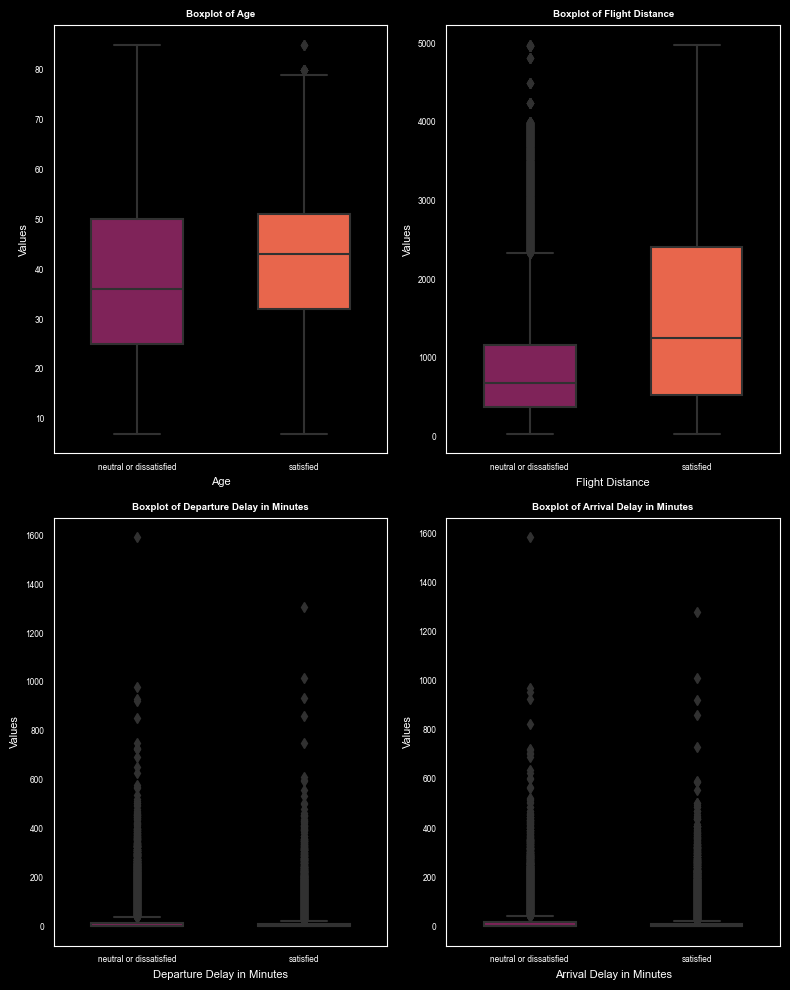

In [16]:
%matplotlib inline
plot_box(train_df)

In [17]:
def plot_hist(df):
    numerical_cols = ['Age','Flight Distance','Departure Delay in Minutes','Arrival Delay in Minutes','Overall']
    num_plots = len(numerical_cols)
    nrows = (num_plots+1)//2
    ncols = 2
    fig, axes = plt.subplots(figsize=(12,14),nrows=nrows,ncols=ncols,facecolor='black')
    for i,column in enumerate(numerical_cols):
        row = i//2
        col = i%2
        ax = axes[row,col]
        ax.set_facecolor('black')
        sns.histplot(x=column,data=df,palette='magma',hue='satisfaction',bins=60,kde=True,ax=ax)
        ax.set_title(f'Histplot of {column}', color='white', fontsize=7, weight='bold')
        ax.set_xlabel(f'{column}', color='white', fontsize=8)
        ax.set_ylabel('Values', color='white', fontsize=8)
        
        ax.tick_params(axis='x', colors='white', labelsize=6)
        ax.tick_params(axis='y', colors='white', labelsize=6)
        
        for spine in ax.spines.values():
            spine.set_edgecolor('white')
        
        # Handle legend if present
        legend = ax.get_legend()
        if legend is not None:
            legend.get_frame().set_facecolor('black')
            legend.get_frame().set_edgecolor('white')
            plt.setp(legend.get_texts(), color='white')
    plt.tight_layout()
    plt.show()

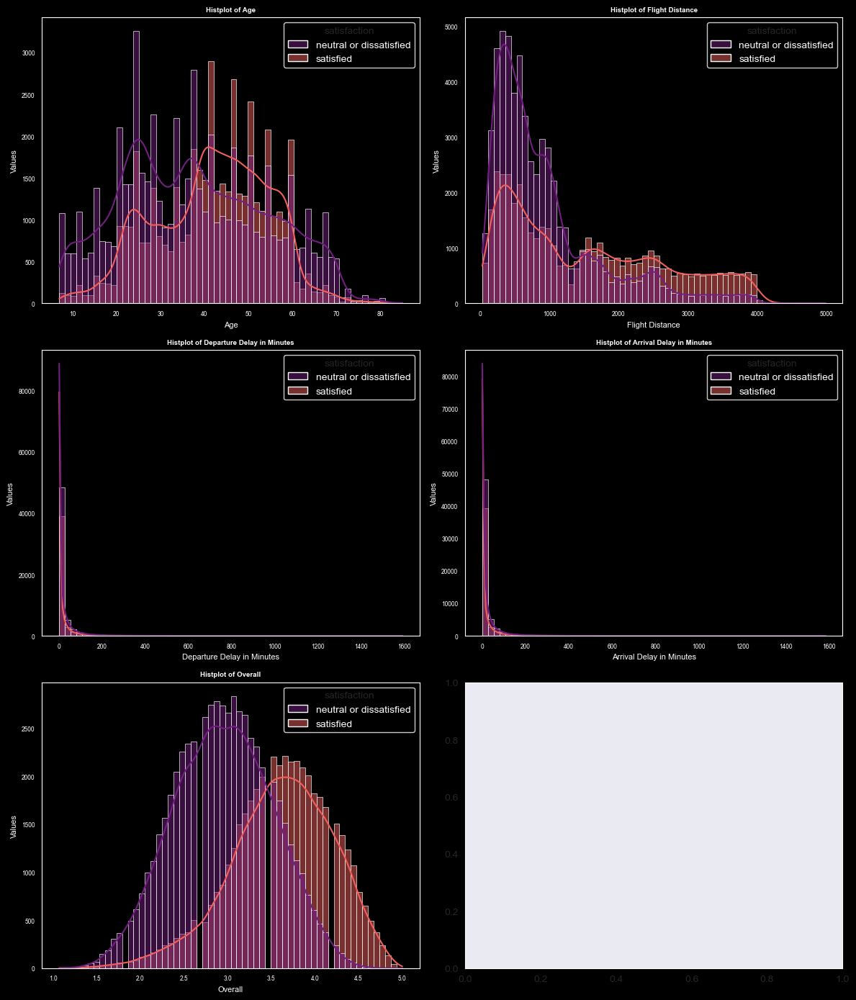

In [18]:
plot_hist(train_df)

In [19]:
def plot_count(df):
    cat_cols = cat_cols = ['Gender', 'Customer Type','Type of Travel', 'Class','Inflight wifi service',
       'Departure/Arrival time convenient', 'Ease of Online booking',
       'Gate location', 'Food and drink', 'Online boarding', 'Seat comfort',
       'Inflight entertainment', 'On-board service', 'Leg room service',
       'Baggage handling', 'Checkin service', 'Inflight service',
       'Cleanliness']
    num_plots = len(cat_cols)
    nrows = (num_plots+2)//3
    ncols = 3
    fig, axes = plt.subplots(figsize=(30,40),nrows=nrows,ncols=ncols,facecolor='black')
    for i,column in enumerate(cat_cols):
        row = i//3
        col = i%3
        ax = axes[row,col]
        ax.set_facecolor('black')
        sns.countplot(x=column,data=df,palette='Set3',ax=ax,hue='satisfaction',linewidth=0.5)
        ax.set_title(f'Countplot of {column}', color='white', fontsize=14, weight='bold')
        ax.set_xlabel(f'{column}', color='white', fontsize=12)
        ax.set_ylabel('Values', color='white', fontsize=12)
        
        ax.tick_params(axis='x', colors='white', labelsize=10)
        ax.tick_params(axis='y', colors='white', labelsize=10)
        
        for spine in ax.spines.values():
            spine.set_edgecolor('white')
        
        # Handle legend if present
        legend = ax.get_legend()
        if legend is not None:
            legend.get_frame().set_facecolor('black')
            legend.get_frame().set_edgecolor('white')
            plt.setp(legend.get_texts(), color='white')
    plt.tight_layout()
    plt.show()

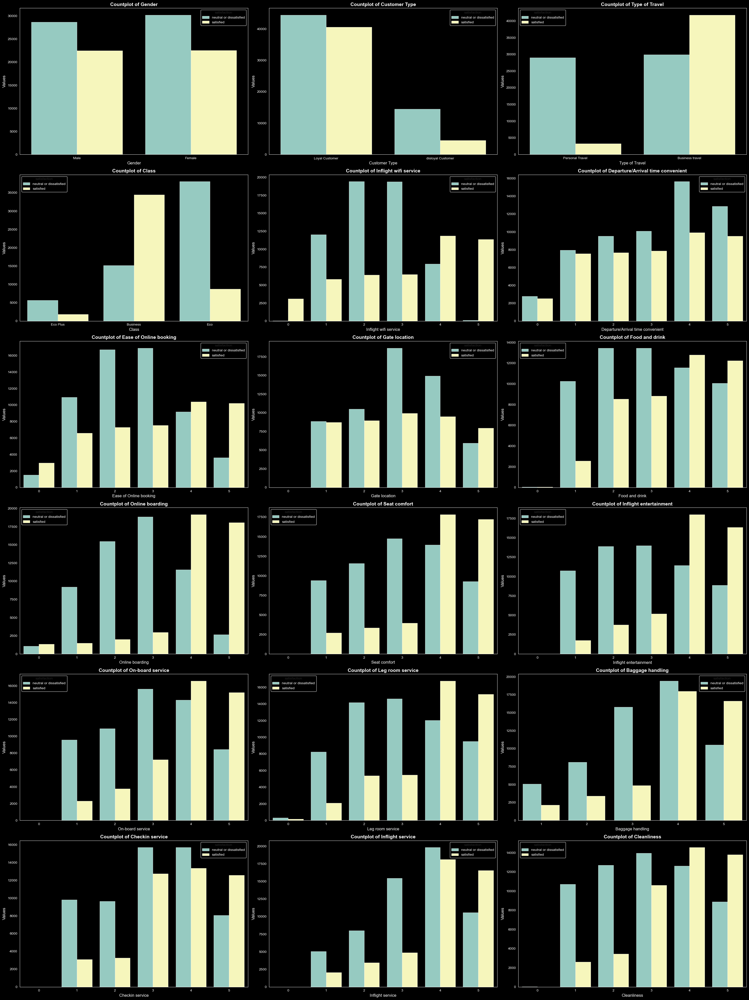

In [20]:
plot_count(train_df)

In [21]:
train_df['satisfaction'].value_counts()

satisfaction
neutral or dissatisfied    58879
satisfied                  45025
Name: count, dtype: int64

In [22]:
train_df['satisfaction'] = train_df['satisfaction'].astype('category').cat.codes
test_df['satisfaction'] = test_df['satisfaction'].astype('category').cat.codes

In [23]:
for col in cat_cols:
    train_df[col] = train_df[col].astype('category')
    test_df[col] = test_df[col].astype('category')
    train_df[col] = train_df[col].cat.add_categories('unknown')
    test_df[col] = test_df[col].cat.set_categories(train_df[col].cat.categories)

In [24]:
cat_train = np.stack([train_df[col].cat.codes for col in cat_cols],axis=1)
cat_test = np.stack([test_df[col].cat.codes for col in cat_cols],axis=1)

In [25]:
cat_train = torch.LongTensor(cat_train).to(device)
cat_test = torch.LongTensor(cat_test).to(device)

In [26]:
cont_train = np.stack([train_df[col].values for col in num_cols],axis=1)
cont_test = np.stack([test_df[col].values for col in num_cols],axis=1)

In [27]:
cont_train = torch.Tensor(cont_train).to(device)
cont_test = torch.Tensor(cont_test).to(device)

In [28]:
y_train = torch.Tensor(train_df[target_col].values).to(device)
y_test = torch.Tensor(test_df[target_col].values).to(device)

In [29]:
cat_szs_train = [len(train_df[col].cat.categories) for col in cat_cols]
cat_szs_test = [len(test_df[col].cat.categories) for col in cat_cols]

In [30]:
emb_szs = [(size,min(50,(size+1)//2)) for size in cat_szs_train]

In [31]:
emb_szs

[(3, 2),
 (3, 2),
 (3, 2),
 (4, 2),
 (7, 4),
 (7, 4),
 (7, 4),
 (7, 4),
 (7, 4),
 (7, 4),
 (7, 4),
 (7, 4),
 (7, 4),
 (7, 4),
 (6, 3),
 (7, 4),
 (7, 4),
 (7, 4),
 (57, 29)]

In [57]:
class Model(nn.Module):
    #initializer
    def __init__(self,emb_szs,n_cont,layers,out_size,p=0.4):
        super(Model,self).__init__()
        self.embeds = nn.ModuleList([nn.Embedding(ni,nf) for ni,nf in emb_szs])
        self.emb_drop = nn.Dropout(p)
        n_embs = sum([nf for ni,nf in emb_szs])
        #handling continuos variables
        self.bn_cont = nn.BatchNorm1d(n_cont)
        n_in = n_embs + n_cont
        #laeyrlist containing Lin -> Relu -> batchnorm -> Drop
        layerlist = []
        #creating layerlist
        for i in layers:
            layerlist.append(nn.Linear(n_in,i))
            layerlist.append(nn.ReLU(inplace=True))
            layerlist.append(nn.BatchNorm1d(i))
            layerlist.append(nn.Dropout(p))
            n_in = i
        layerlist.append(nn.Linear(layers[-1],out_size))
        self.layers = nn.Sequential(*layerlist)
    
    #forward
    def forward(self,x_cat,x_cont):
        embeddings = []
        for i,e in enumerate(self.embeds):
            embeddings.append(e(x_cat[:,i]))
        x = torch.cat(embeddings,1)
        x = self.emb_drop(x)
        x_cont = self.bn_cont(x_cont)
        
        x = torch.cat([x,x_cont],1)
        
        x = self.layers(x)
        return x
            
        

In [122]:
model = Model(emb_szs,cont_train.shape[1],[32,16,8,4],out_size=2,p=0.3)

In [123]:
model = model.to(device)

In [124]:
model

Model(
  (embeds): ModuleList(
    (0-2): 3 x Embedding(3, 2)
    (3): Embedding(4, 2)
    (4-13): 10 x Embedding(7, 4)
    (14): Embedding(6, 3)
    (15-17): 3 x Embedding(7, 4)
    (18): Embedding(57, 29)
  )
  (emb_drop): Dropout(p=0.3, inplace=False)
  (bn_cont): BatchNorm1d(4, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (layers): Sequential(
    (0): Linear(in_features=96, out_features=32, bias=True)
    (1): ReLU(inplace=True)
    (2): BatchNorm1d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (3): Dropout(p=0.3, inplace=False)
    (4): Linear(in_features=32, out_features=16, bias=True)
    (5): ReLU(inplace=True)
    (6): BatchNorm1d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): Dropout(p=0.3, inplace=False)
    (8): Linear(in_features=16, out_features=8, bias=True)
    (9): ReLU(inplace=True)
    (10): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): Dropout(p=0

In [125]:
num_epochs = 300
optimizer = torch.optim.Adam(model.parameters(),lr=0.005)
criterion = nn.CrossEntropyLoss()

In [126]:
for epoch in range(num_epochs):
    y_pred = model.forward(cat_train,cont_train)
    loss = criterion(y_pred,y_train.squeeze())
    if (epoch+1)%50 == 0 :
        print(f"epoch : {epoch+1} loss : {loss.item()}")
    optimizer.zero_grad()
    loss.backward()
    optimizer.step()

epoch : 50 loss : 0.34298038482666016
epoch : 100 loss : 0.23722602427005768
epoch : 150 loss : 0.1955619752407074
epoch : 200 loss : 0.1771627515554428
epoch : 250 loss : 0.1678115725517273
epoch : 300 loss : 0.1612149178981781


In [127]:
with torch.no_grad():
    y_eval = model.forward(cat_test,cont_test)
    loss_eval = criterion(y_eval,y_test.squeeze())

In [128]:
print(loss_eval.item())

0.16976046562194824


In [129]:
y_eval = torch.argmax(y_eval,axis=1).cpu().numpy()

In [99]:
y_eval

array([1, 1, 0, ..., 0, 1, 0])

In [130]:
from sklearn.metrics import classification_report
print(classification_report(y_eval,y_test.cpu().numpy()))

              precision    recall  f1-score   support

           0       0.97      0.92      0.94     15306
           1       0.89      0.96      0.92     10670

    accuracy                           0.94     25976
   macro avg       0.93      0.94      0.93     25976
weighted avg       0.94      0.94      0.94     25976

